# CEE 690-02

# Environmental Spatial Data Analysis

# Lecture 24

# Logistics

* Homework #8 due next Tuesday
* Reza will not be available next Monday. He will be holding office hours this Friday from 8-10 am (same place) instead.

# Terrain analysis: Elevation data and its derivatives

# Most of you have done terrain analysis already...

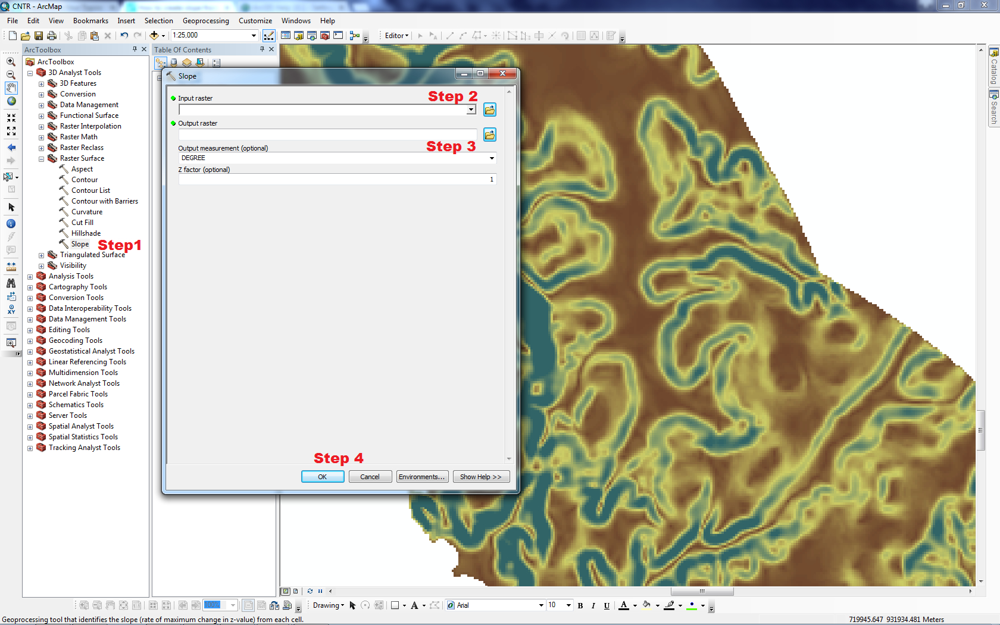

However, chances are you had no idea what you were doing (other than pressing buttons).

# We are going to try to change that today

# DEM data

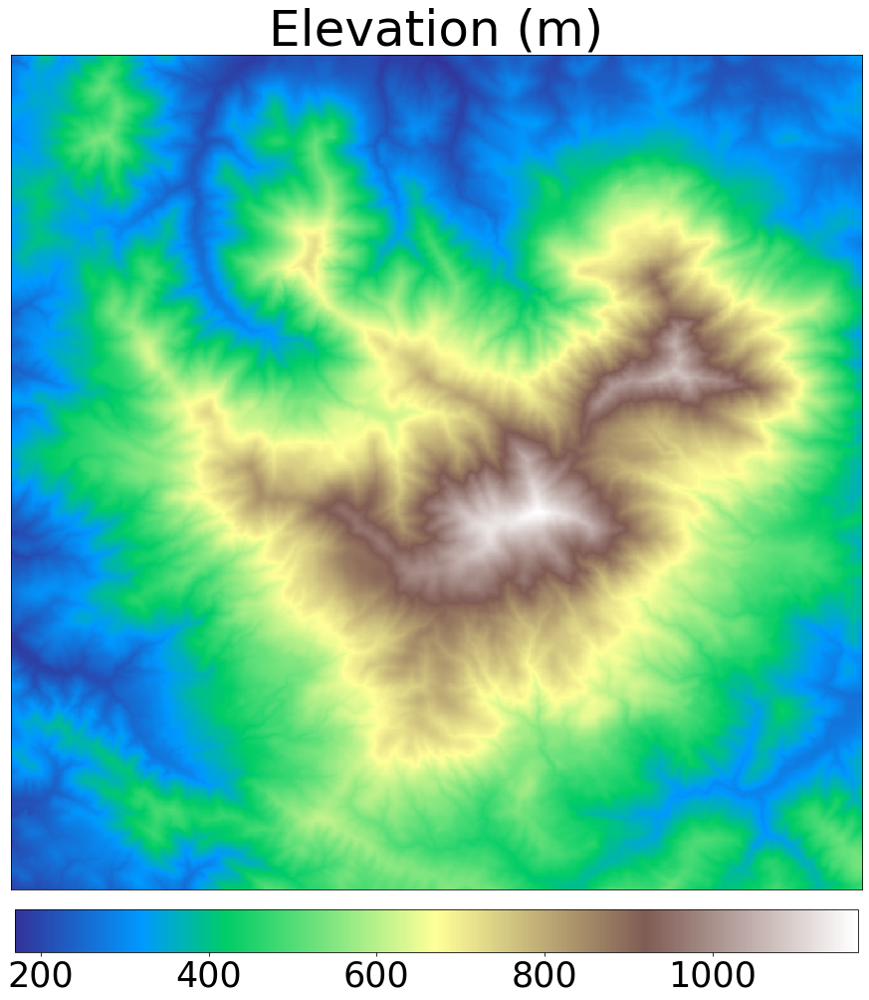

# DEM data structure

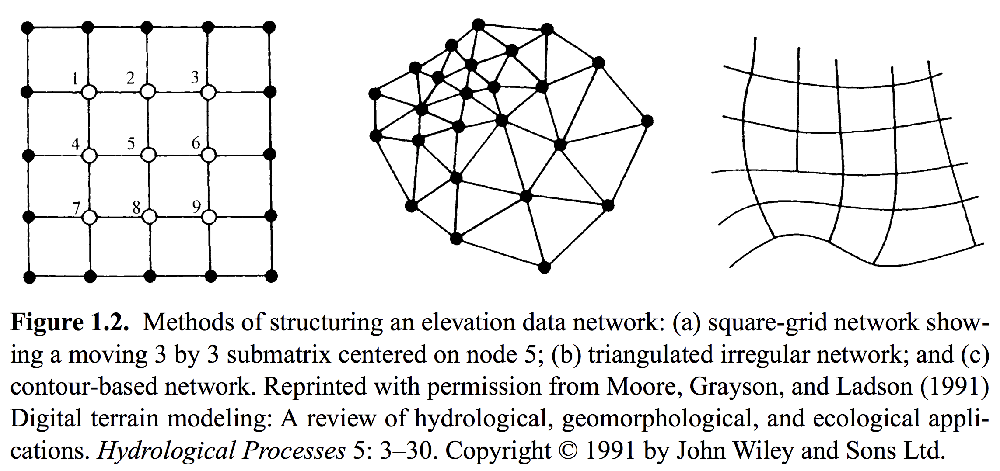



# DEM vs DTM vs DSM

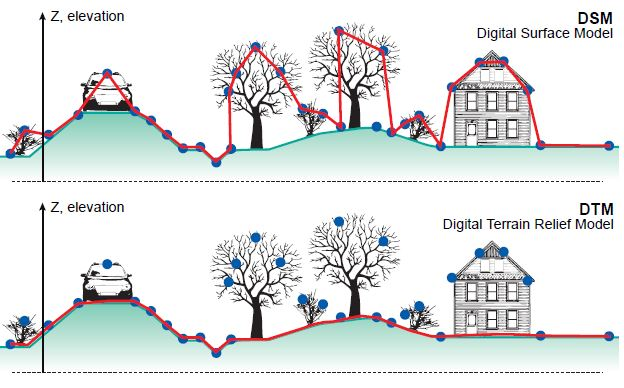

**DEM** - Digital elevation model

**DTM** - Digital terrain model

**DSM** - Digital surface model

*DEM is a generic term that encompasses both DTM and DSM*

# DSM vs DEM

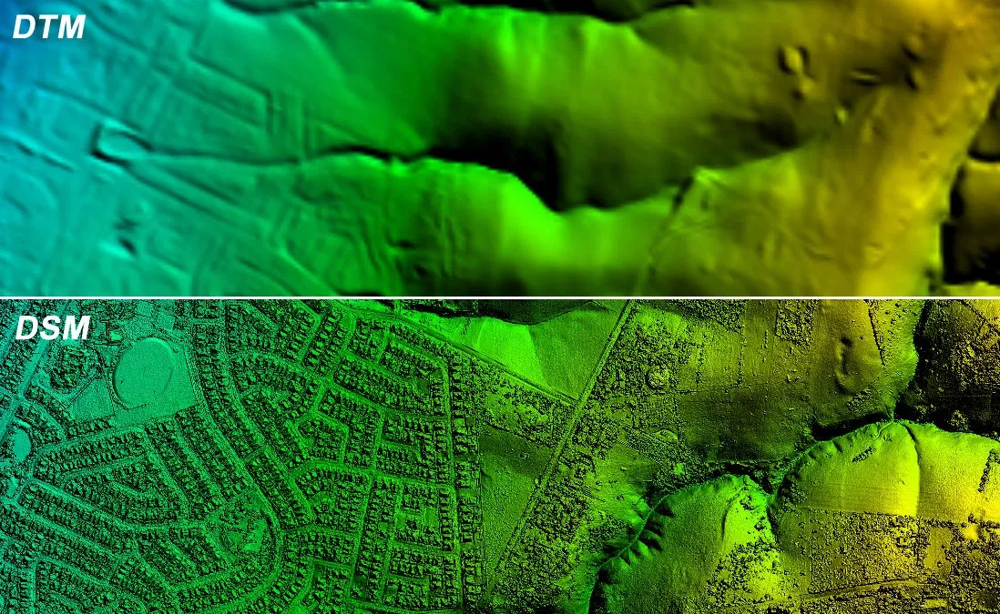

# Where are DEMs used?

* Geomorphology
* Hydrology
* 3D flight planning
* Rectification of aerial photography or satellite imagery
* Terrain correction of gravity measurements
* Engineering and infrastructure design
* Satellite navigation
* Line of sight analysis
* Flight simulation
* Precision farming and forestry
* Intelligent transportation systems
* Archaeology

Source: Wikipedia

# Case study: Mount Diablo, California

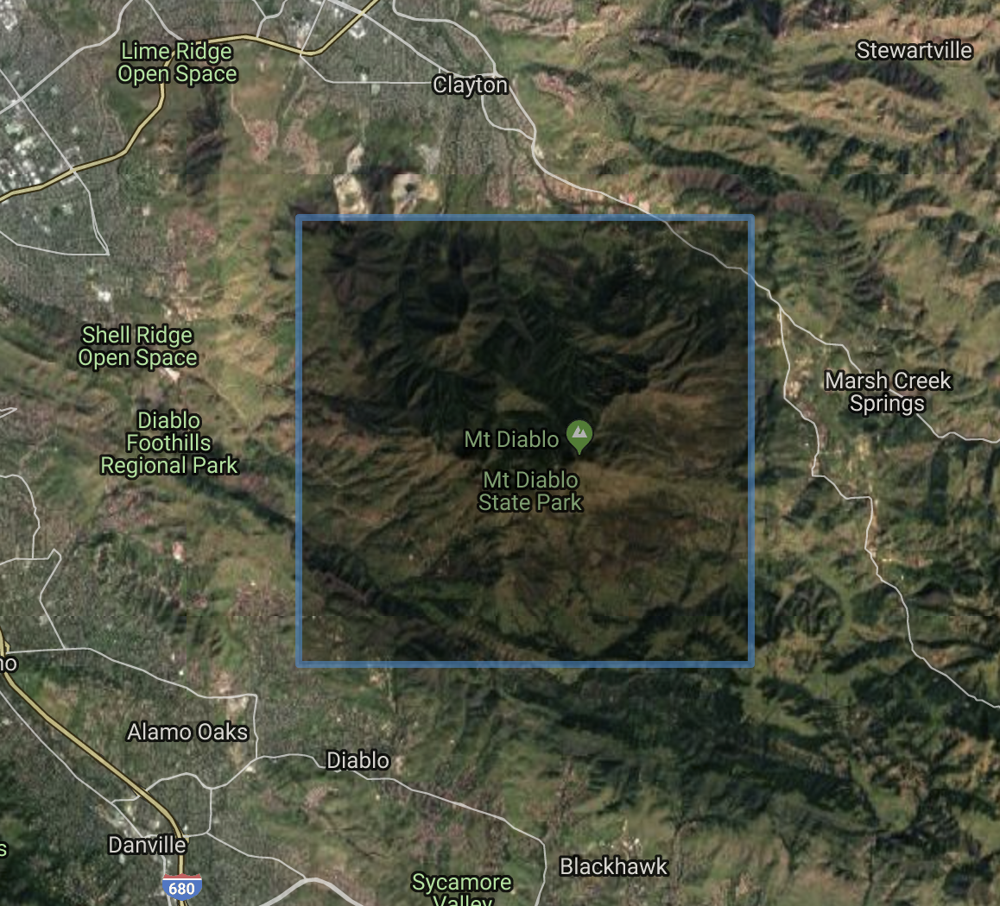

# Another view

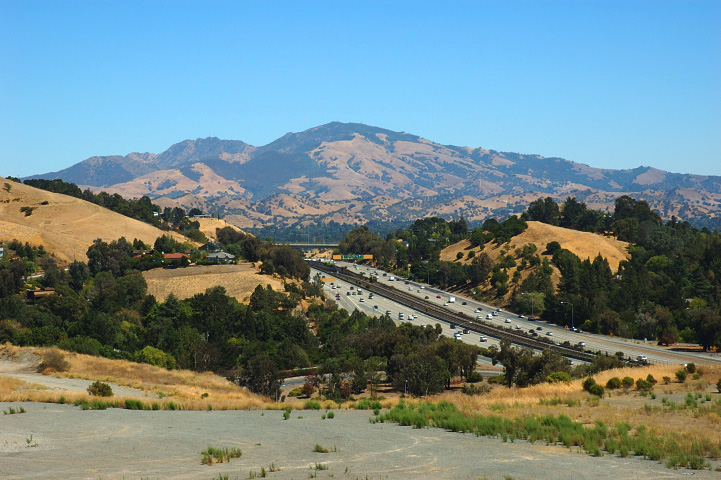

In [2]:
%%bash 
gdalwarp -overwrite -te -121.97 37.85 -121.88 37.92 -t_srs EPSG:4326 -tr 0.000027777 0.000027777 /data/3DEP/ned19_n38x00_w122x00_ca_contracostaco_2008.img ../Workspace/tmp.tif
gdalwarp -overwrite -dstnodata -9999 -r average -tr 10 10 -t_srs '+proj=aea +lat_1=37.85 +lat_2=37.92 +lat_0=37.885 +lon_0=-121.93 +x_0=0 +y_0=0 +ellps=GRS80 +towgs84=0,0,0,0,0,0,0 +units=m +no_defs' ../Workspace/tmp.tif ../Workspace/dem.tif



Copying raster attribute table from /data/3DEP/ned19_n38x00_w122x00_ca_contracostaco_2008.img to new file.
Creating output file that is 3240P x 2520L.
Processing /data/3DEP/ned19_n38x00_w122x00_ca_contracostaco_2008.img [1/1] : 0Using internal nodata values (e.g. -3.40282e+38) for image /data/3DEP/ned19_n38x00_w122x00_ca_contracostaco_2008.img.
Copying nodata values from source /data/3DEP/ned19_n38x00_w122x00_ca_contracostaco_2008.img to destination ../Workspace/tmp.tif.
...10...20...30...40...50...60...70...80...90...100 - done.
Creating output file that is 792P x 777L.
Processing ../Workspace/tmp.tif [1/1] : 0Using internal nodata values (e.g. -3.40282e+38) for image ../Workspace/tmp.tif.
...10...20...30...40...50...60...70...80...90...100 - done.


pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed
pj_obj_create: Open of /opt/conda/share/proj failed


# Mount Diablo elevation data

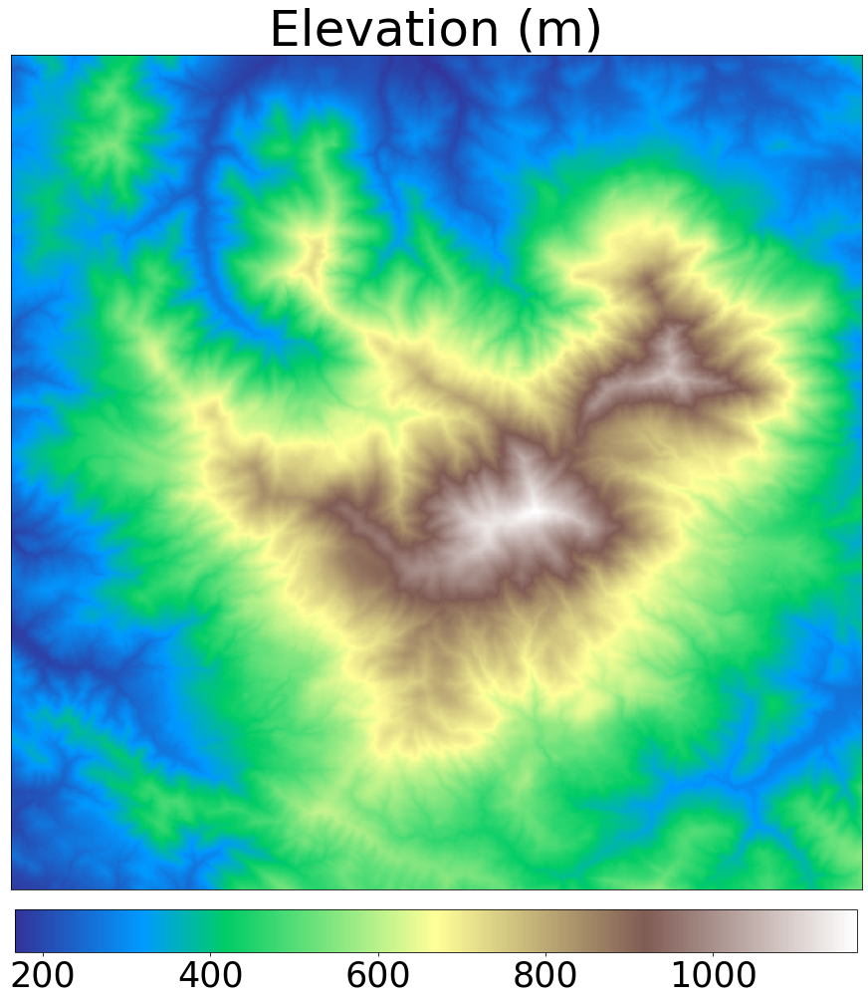

In [3]:
import rasterio
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
dem = rasterio.open('../Workspace/dem.tif').read(1)[1:-1,1:-1]
plt.figure(figsize=(15,15))
plt.imshow(dem,cmap='terrain')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Elevation (m)',fontsize=50)
plt.tight_layout()
plt.show()

# Let's interpret elevation data as a 3d surface

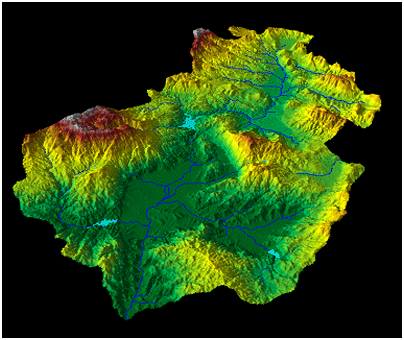

Where:

$$z = f(x,y)$$

We can then envision calculating local partial derivatives to define locally varying properties (e.g., gradient/slope).

# Partial derivatives of the elevation data

### First order
$$z_x = \frac{\partial z}{\partial x}$$

$$z_y = \frac{\partial z}{\partial y}$$

### Second order
$$z_{xx} = \frac{\partial^2z}{\partial x^2}$$

$$z_{yy} = \frac{\partial^2z}{\partial y^2}$$

$$z_{xy} = \frac{\partial^2}{\partial x\partial y}$$

Most primary terrain attributes are computed from these partial derivatives

# Grid: Indexing a point's neighborhood

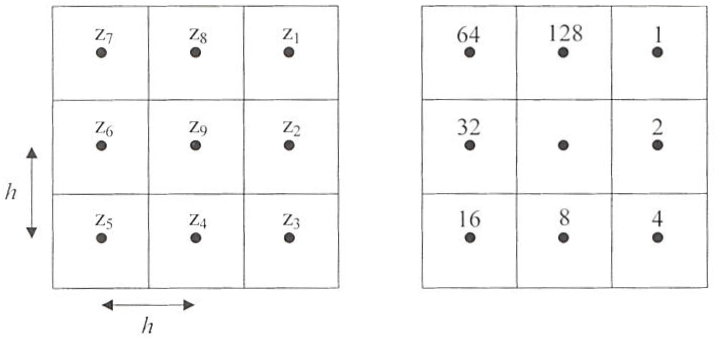


# Calculating Partial Derivatives: Finite differences

We are going to use centered finite differences:

### First order
$$z_x = \frac{\partial z}{\partial x} \approx \frac{z_2 - z_6}{2h}$$

$$z_y = \frac{\partial z}{\partial y} \approx \frac{z_8 - z_4}{2h}$$

### Second order
$$z_{xx} = \frac{\partial^2z}{\partial x^2} \approx \frac{z_2 - 2z_9 + z_6}{h^2}$$

$$z_{yy} = \frac{\partial^2z}{\partial y^2} \approx \frac{z_8 - 2z_9 + z_4}{h^2}$$

$$z_{xy} = \frac{\partial^2}{\partial x\partial y} \approx \frac{-z_7 + z_1 + z_5 - z_3}{4h^2}$$

# Partial derivatives from the data

In [4]:
def calculate_zx(z,h):
    return (dem[1:-1,2:] - dem[1:-1,:-2])/(2*h)
def calculate_zy(z,h):
    return (dem[:-2,1:-1] - dem[2:,1:-1])/(2*h)
def calculate_zxx(z,h):
    return (dem[1:-1,2:] -2*dem[1:-1,1:-1] + dem[1:-1,:-2])/(h**2)
def calculate_zyy(z,h):
    return (dem[:-2,1:-1] -2*dem[1:-1,1:-1] + dem[2:,1:-1])/(h**2)
def calculate_zxy(z,h):
    return (-dem[:-2,:-2] + dem[:-2,2:] + dem[2:,:-2] - dem[2:,2:])/(4*h**2)

In [5]:
h = 10 #meters
zx = calculate_zx(dem,h)
zy = calculate_zy(dem,h)
zxx = calculate_zxx(dem,h)
zyy = calculate_zyy(dem,h)
zxy = calculate_zxy(dem,h)

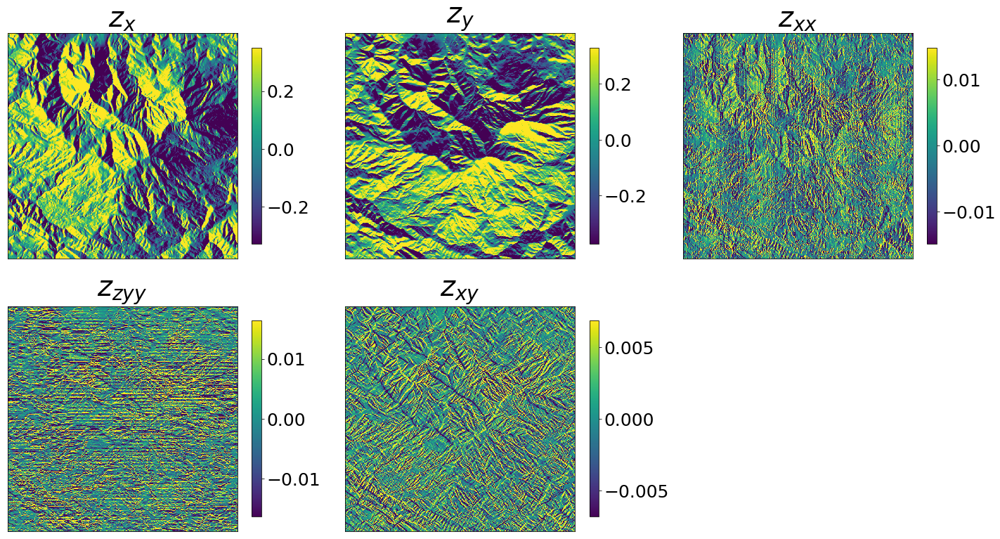

In [6]:
h = 10 #meters
plt.figure(figsize=(20,11))
plt.subplot(2,3,1)
plt.imshow(zx,vmin=np.mean(zx)-np.std(zx),vmax=np.mean(zx)+np.std(zx))
plt.xticks([])
plt.yticks([])
plt.title(r'$z_{x}$',fontsize=40)
cb = plt.colorbar(shrink=0.8)
cb.ax.tick_params(labelsize=25)
plt.subplot(2,3,2)
plt.imshow(zy,vmin=np.mean(zy)-np.std(zy),vmax=np.mean(zy)+np.std(zy))
plt.xticks([])
plt.yticks([])
plt.title(r'$z_{y}$',fontsize=40)
cb = plt.colorbar(shrink=0.8)
cb.ax.tick_params(labelsize=25)
plt.subplot(2,3,3)
plt.imshow(zxx,vmin=np.mean(zxy)-np.std(zxx),vmax=np.mean(zxx)+np.std(zxx))
plt.xticks([])
plt.yticks([])
plt.title(r'$z_{xx}$',fontsize=40)
cb = plt.colorbar(shrink=0.8)
cb.ax.tick_params(labelsize=25)
plt.subplot(2,3,4)
plt.imshow(zyy,vmin=np.mean(zyy)-np.std(zyy),vmax=np.mean(zyy)+np.std(zyy))
plt.xticks([])
plt.yticks([])
plt.title(r'$z_{zyy}$',fontsize=40)
cb = plt.colorbar(shrink=0.8)
cb.ax.tick_params(labelsize=25)
plt.subplot(2,3,5)
plt.imshow(zxy,vmin=np.mean(zxy)-np.std(zxy),vmax=np.mean(zxy)+np.std(zxy))
plt.xticks([])
plt.yticks([])
plt.title(r'$z_{xy}$',fontsize=40)
cb = plt.colorbar(shrink=0.8)
cb.ax.tick_params(labelsize=25)
plt.tight_layout()
plt.show()

# Slope: Concept and implementation

Let's assume that the slope at a given point is defined via:

$$s = \sqrt{(z_x)^2 + (z_y)^2}$$

In [7]:
def calculate_slope(z,h):
    zx = calculate_zx(z,h)
    zy = calculate_zy(z,h)
    return 100*(zx**2 + zy**2)**0.5 #percent

# Slope: Example

In [8]:
slope = calculate_slope(dem,10)

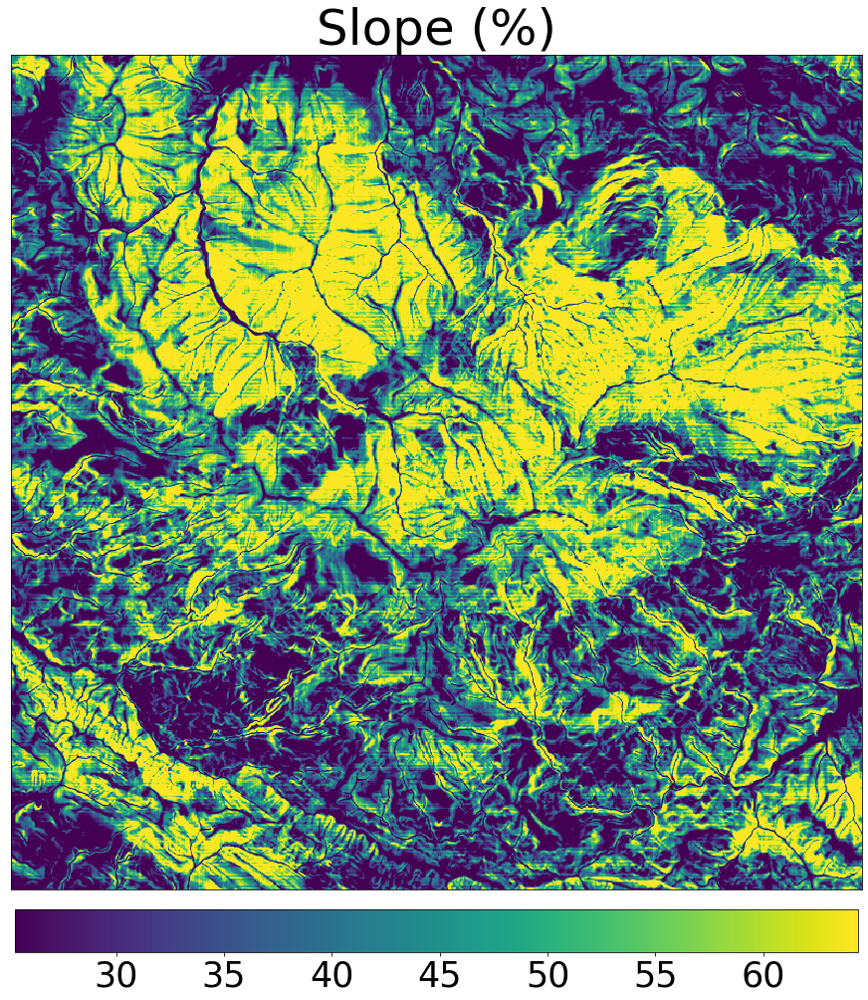

In [9]:
plt.figure(figsize=(15,15))
plt.imshow(slope,cmap='viridis',vmin=np.mean(slope)-np.std(slope),vmax=np.mean(slope)+np.std(slope))
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Slope (%)',fontsize=50)
plt.tight_layout()
plt.show()

# Aspect: Concept and implementation

Definition: Orientation of the line of steepest descent 

$$\psi = 180 - \arctan\left(\frac{z_y}{z_x}\right) + 90\left(\frac{z_x}{|z_x|}\right)$$

In [10]:
def calculate_aspect(z,h):
    zx = calculate_zx(z,h)
    zy = calculate_zy(z,h)
    zx[zx == 0.0] = 10**-5
    zy[zy == 0.0] = 10**-5
    aspect = 57.2958*(np.pi - np.arctan(zy/zx) + np.pi/2*(zx/np.abs(zx)))
    return aspect

# Aspect: Example

In [11]:
aspect = calculate_aspect(dem,10)

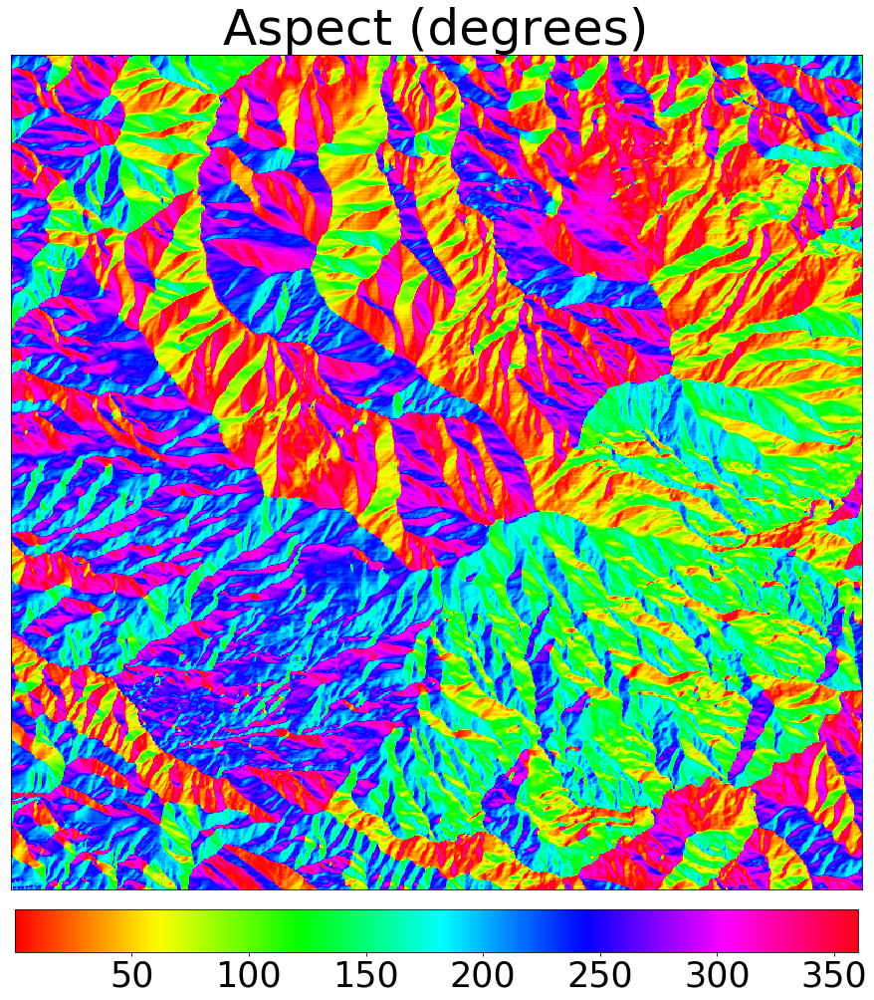

In [12]:
plt.figure(figsize=(15,15))
plt.imshow(aspect,cmap='hsv')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Aspect (degrees)',fontsize=50)
plt.tight_layout()
plt.show()

# Convert to cartesian coordinates



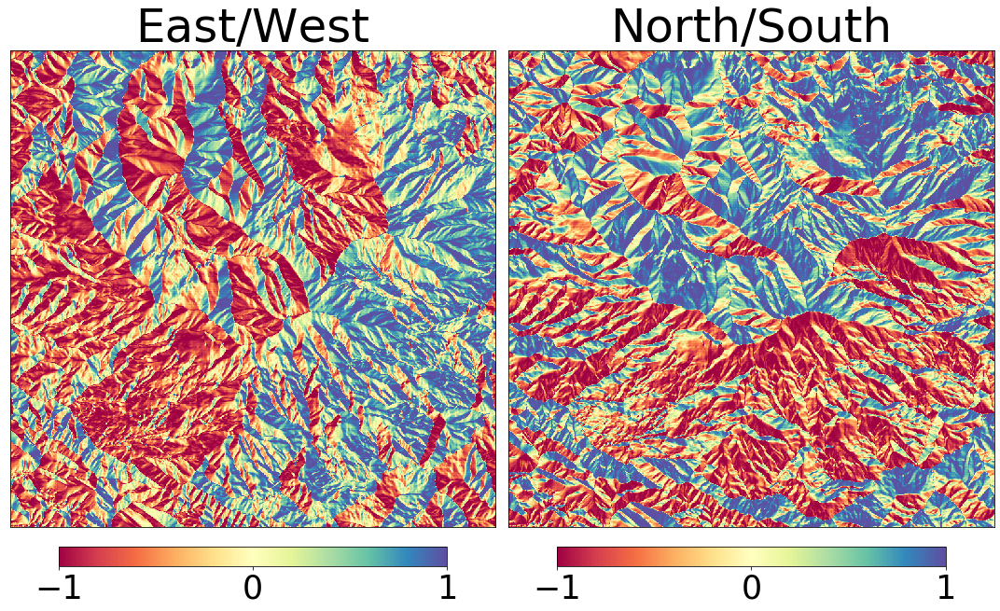

In [152]:
x = np.sin(aspect/57.2958)
y = np.cos(aspect/57.2958)
plt.figure(figsize=(15,15))
plt.subplot(121)
plt.imshow(x,cmap='Spectral')#,vmin=0,vmax=100)
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('East/West',fontsize=50)
plt.subplot(122)
plt.imshow(y,cmap='Spectral')#,vmin=0,vmax=100)
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('North/South',fontsize=50)
plt.tight_layout()
plt.show()

# Curvature

Attributes based on the second order derivatives.

Types of curvature:

* Profile curvature
* Plan curvature
* Total curvature

# Profile curvature: Concept and Implementation

It is defined as the rate of change of slope down a flow line. It is important for characterizing changes in flow velocity and sediment transport processes.

It helps differentiate between upper (convex) and lower (concave) slopes.

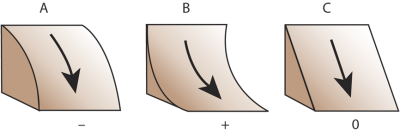

$$K_p = \frac{z_{xx}z_x^2 + 2z_{xy}z_xz_y + z_{yy}z_y^2}{(z_x^2 + z_y^2)(z_x^2 + z_y^2 +1)^{3/2}}$$

In [153]:
def calculate_profile_curvature(z,h):
    zx = calculate_zx(z,h)
    zxx = calculate_zxx(z,h)
    zy = calculate_zy(z,h)
    zyy = calculate_zyy(z,h)
    zxy = calculate_zxy(z,h)
    p = zx**2 + zy**2
    q = p + 1
    return (zxx*zx**2 + 2*zxy*zx*zy + zyy*zy**2)/(p*q**(3/2))

# Profile curvature: Example

In [154]:
kp = calculate_profile_curvature(dem,h)

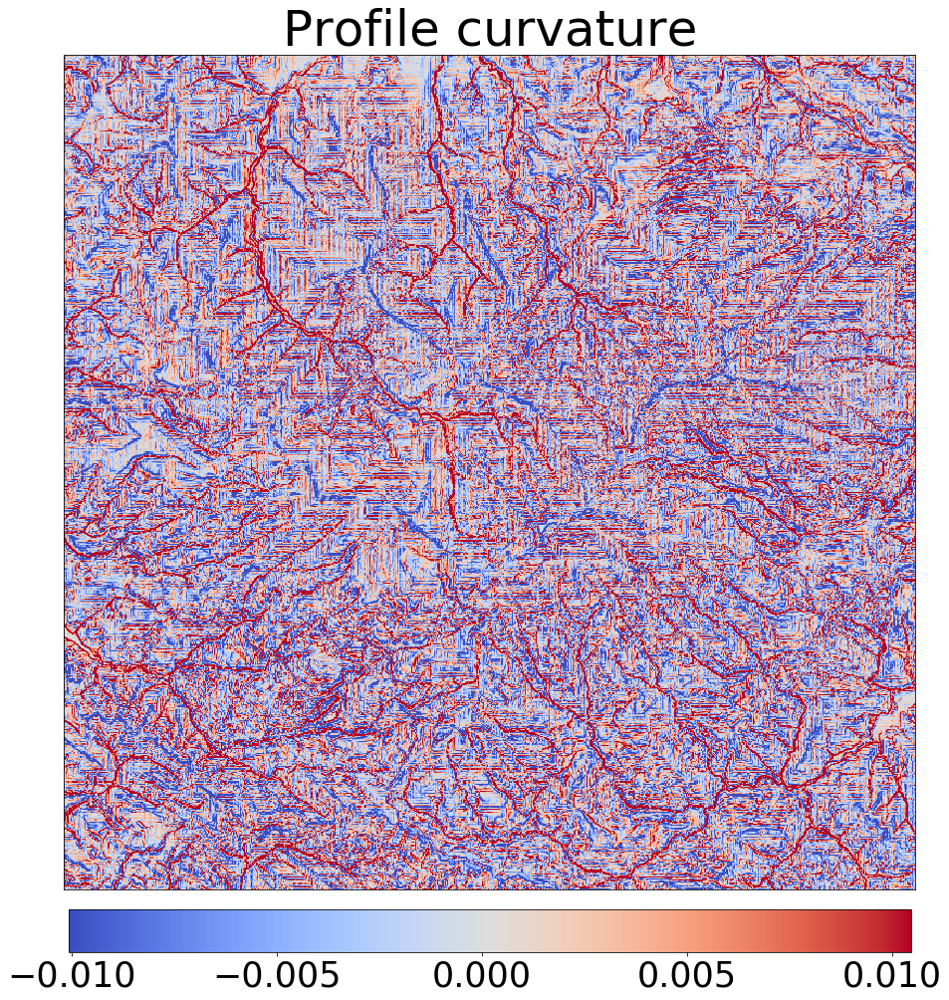

In [155]:
plt.figure(figsize=(15,15))
plt.imshow(kp,cmap='coolwarm',vmin=np.mean(kp)-np.std(kp),vmax=np.mean(kp)+np.std(kp))
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Profile curvature',fontsize=50)
plt.tight_layout()
plt.show()

# Plan curvature: Concept and Implementation

It is defined as the rate of change of aspect along a countor line. It measures topographic convergence and divergence.

It helps differentiate between ridges, valleys, and hillslopes.

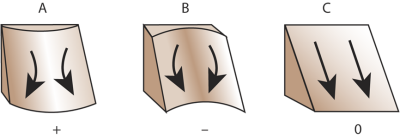


$$K_c = -\frac{z_{xx}z_y^2 - 2z_{xy}z_xz_y + z_{yy}z_x^2}{(z_x^2 + z_y^2)^{3/2}}$$

In [156]:
def calculate_plan_curvature(z,h):
    zx = calculate_zx(z,h)
    zxx = calculate_zxx(z,h)
    zy = calculate_zy(z,h)
    zyy = calculate_zyy(z,h)
    zxy = calculate_zxy(z,h)
    p = zx**2 + zy**2
    q = p + 1
    return -(zxx*zy**2 - 2*zxy*zx*zy + zyy*zx**2)/(p**(3/2))

# Plan curvature: Example

In [157]:
kc = calculate_plan_curvature(dem,h)

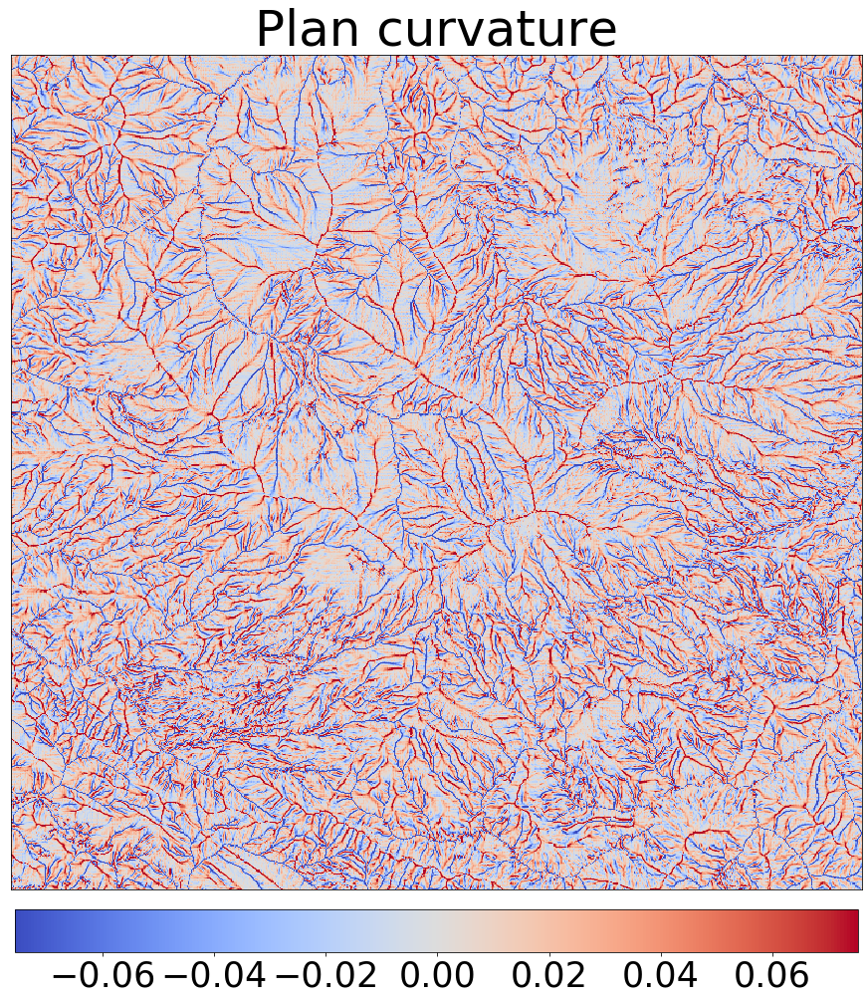

In [158]:
plt.figure(figsize=(15,15))
plt.imshow(kc,cmap='coolwarm',vmin=np.mean(kc)-np.std(kc),vmax=np.mean(kc)+np.std(kc))
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Plan curvature',fontsize=50)
plt.tight_layout()
plt.show()

# Combination of curvature 

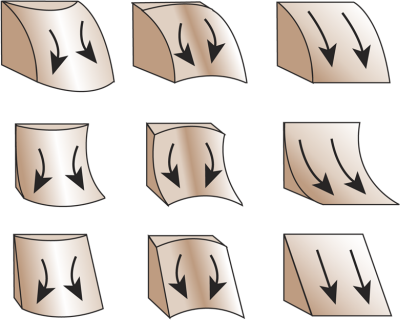

# Total curvature: Concept and Implementation

It is defined as the curvature of the surface itself (instead of the curvature of a line across the surface). It can be positive or convex (indicating peaks), negative or concave (indicating valleys) or zero (indicating flat surface or a saddle).

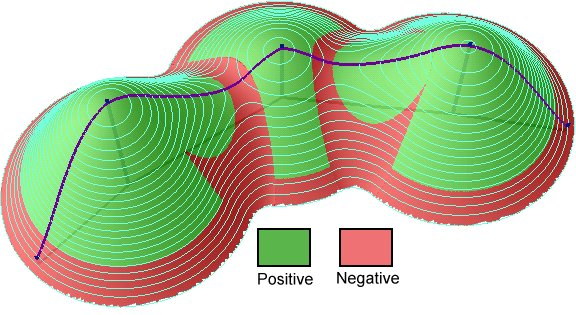

Source: http://www.et-st.com/et_surface/userguide/Raster/ETG_RasterCurvature.htm

$$K = -(z_{xx}^2 + 2z_{xy}^2 + z_{yy}^2)$$

In [160]:
def calculate_total_curvature(z,h):
    zxx = calculate_zxx(z,h)
    zyy = calculate_zyy(z,h)
    zxy = calculate_zxy(z,h)
    return -(zxx**2 + 2*zxy**2 + zyy**2)

# Total curvature: Example

In [161]:
k = calculate_total_curvature(dem,h)

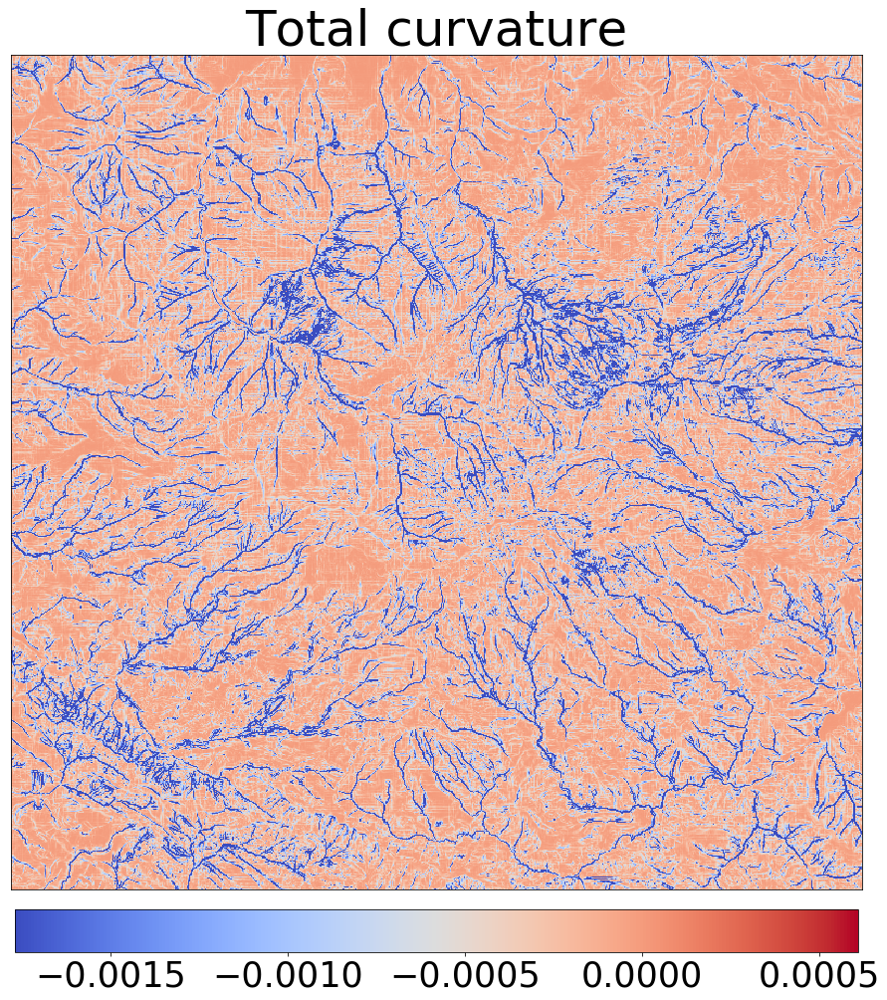

In [162]:
plt.figure(figsize=(15,15))
plt.imshow(k,cmap='coolwarm',vmin=np.mean(k)-np.std(k),vmax=np.mean(k)+np.std(k))
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Total curvature',fontsize=50)
plt.tight_layout()
plt.show()

# Those are the main primary attributes (there are more).

# Secondary terrain attributes

* Geomorphology
* Hydrology
* Soil science
* Lighting
* ...

We are going to explore some basic terrain attributes in hydrology

# Terrain analysis in hydrology

Note that for this stage I will be using a package that I have developed over the years called geospatialtools. If you are interested, uou can clone it from here: https://github.com/chaneyn/geospatialtools.

# Upslope contributing area: Concept

Definition: Area above a certain length of contour that contributes flow across the contour. 

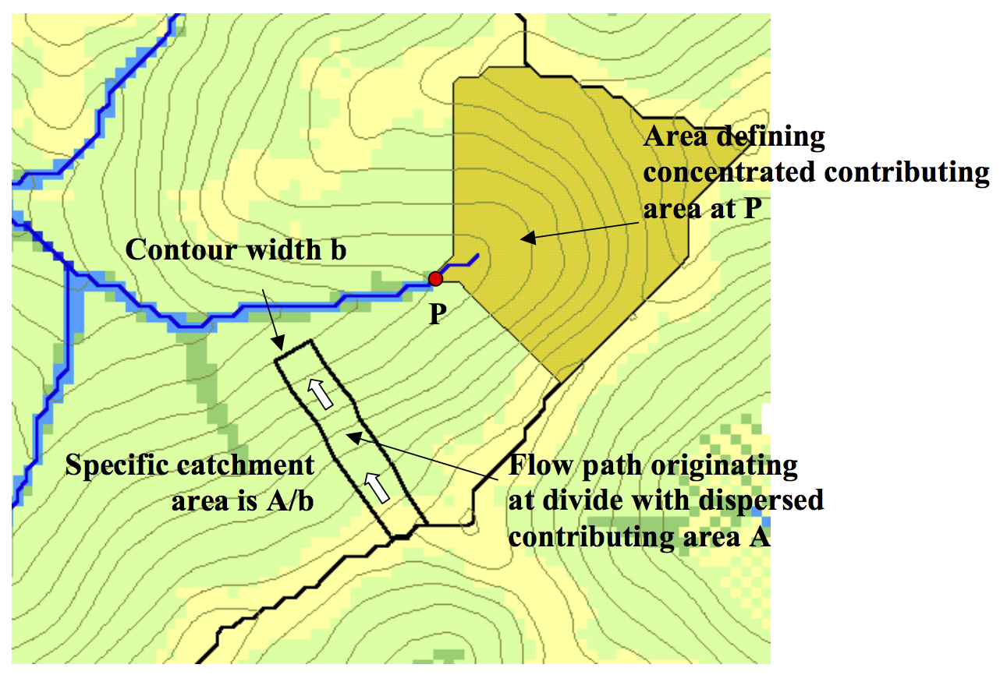

Source: Tarboton, 2003

# Defining flow direction: Different approaches

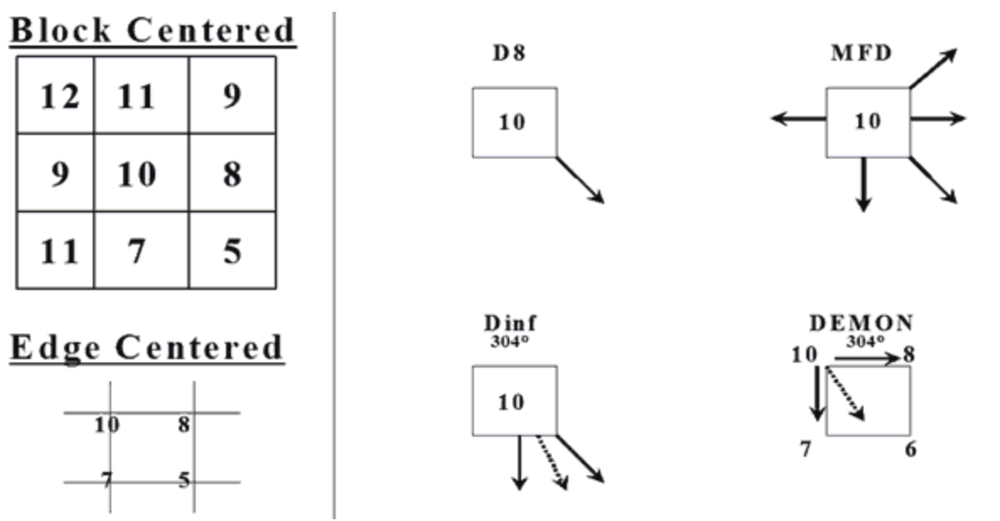

# Role of flow direction algorithm in compute upslope area

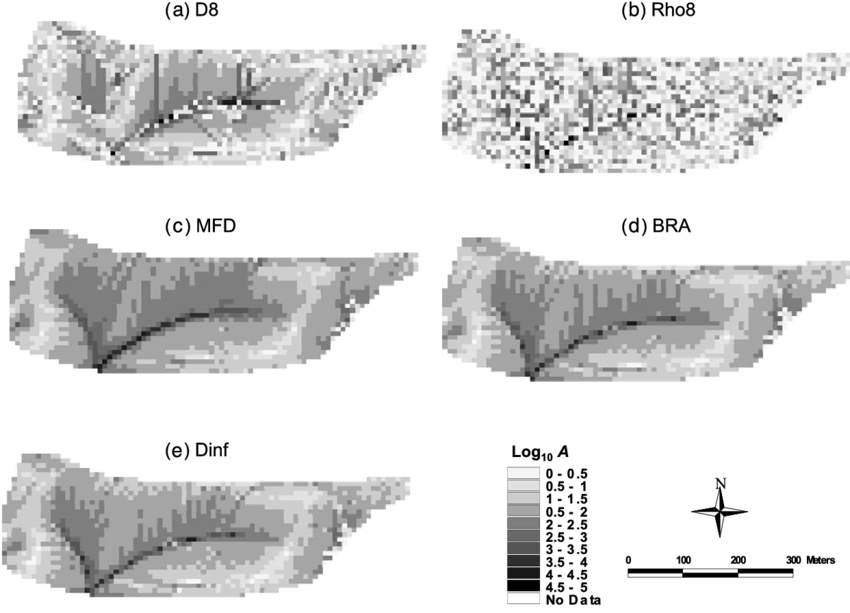

Source: Park et al., 2009

# We are going to use the D8 approach (most common) here

D8 is the same as steepest descent. Tends to be appropriate for channel flow but is not necessarily a good idea for flows down slopes.

# How would you calculate upslope contributing area?

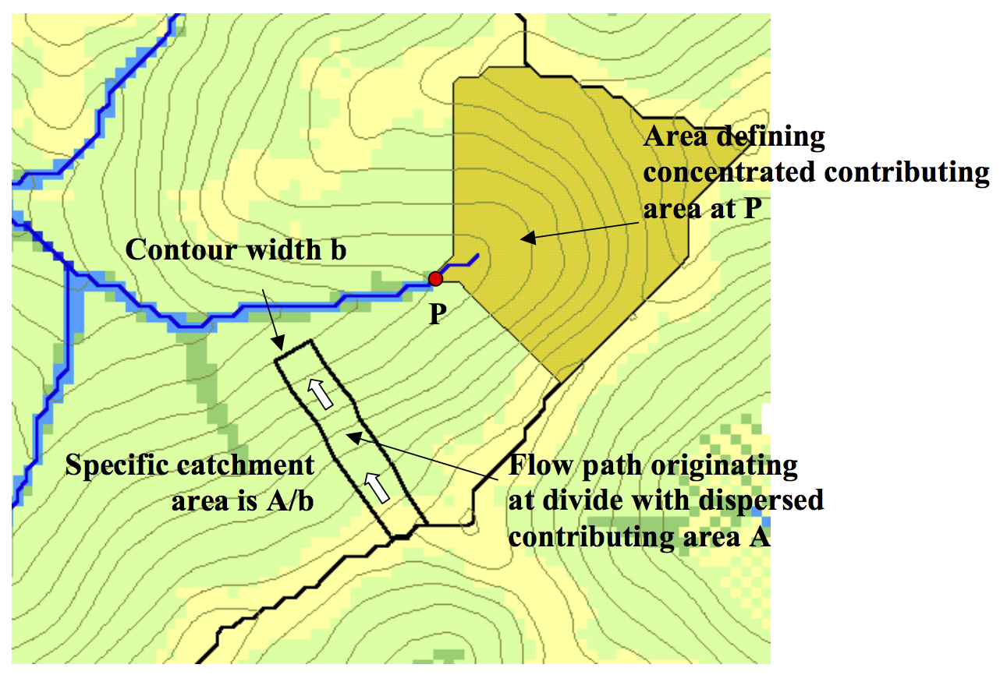

# D8 upslope contributing area: Example

In [62]:
import geospatialtools.terrain_tools as terrain_tools
# Accumulation area
m = np.copy(dem)
m[:] = 1
(area,fdir) = terrain_tools.ttf.calculate_d8_acc(dem[1:-1,1:-1],m[1:-1,1:-1],10)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log10
  


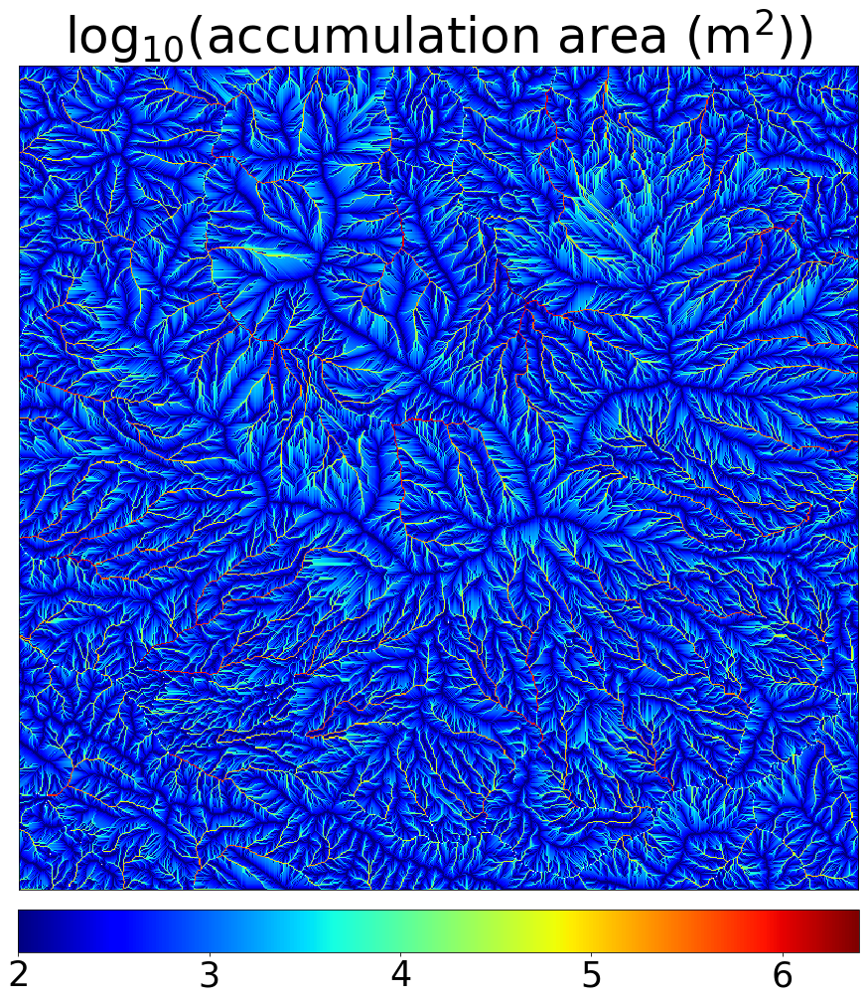

In [63]:
plt.figure(figsize=(15,15))
plt.imshow(np.log10(area),cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title(r'log$_{10}$(accumulation area (m$^2$))',fontsize=50)
plt.tight_layout()
plt.show()

# Something is not right here. Can you guess what?

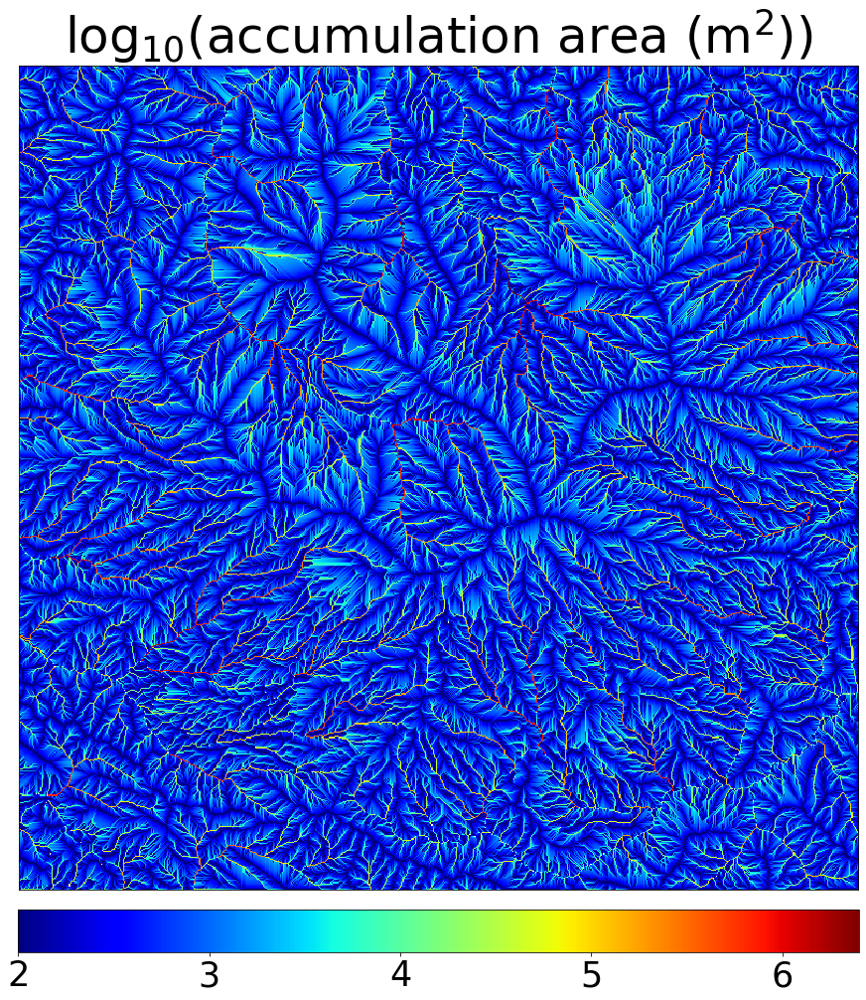

# Let's zoom into to see the problem

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in log10
  


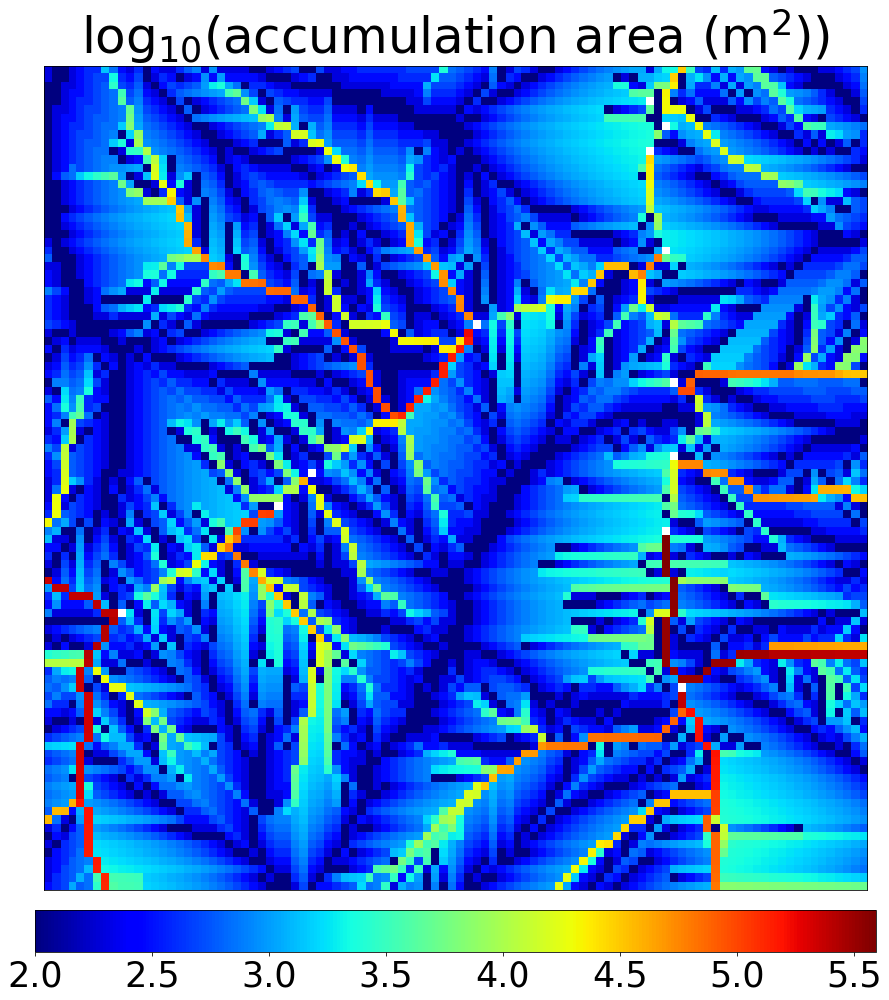

In [64]:
plt.figure(figsize=(15,15))
plt.imshow(np.log10(area[100:200,100:200]),cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title(r'log$_{10}$(accumulation area (m$^2$))',fontsize=50)
plt.tight_layout()
plt.show()

# The random "stops" are due to sinks/pits in the DEM

# Sink filling

If you drop a ball at the top of the mountain in the DEM, chances are it won't make it to one of the edges.

Why? Sinks or pits in the DEM. These can either be real (e.g., depressions) or artificial (e.g., errors in the data). In any case, for hydrologic modeling we prefer to ensure water can flow downhill.

This is called sink filling. There are lots of algorithms out there. From my perspective, how we do it is fairly ad-hoc but it works! 


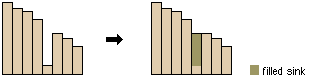

Source: Tarboton, 2003

# Apply sink filling: Compare to original elevation

In [65]:
dem_ns = terrain_tools.ttf.remove_pits_planchon(dem[1:-1,1:-1],10)

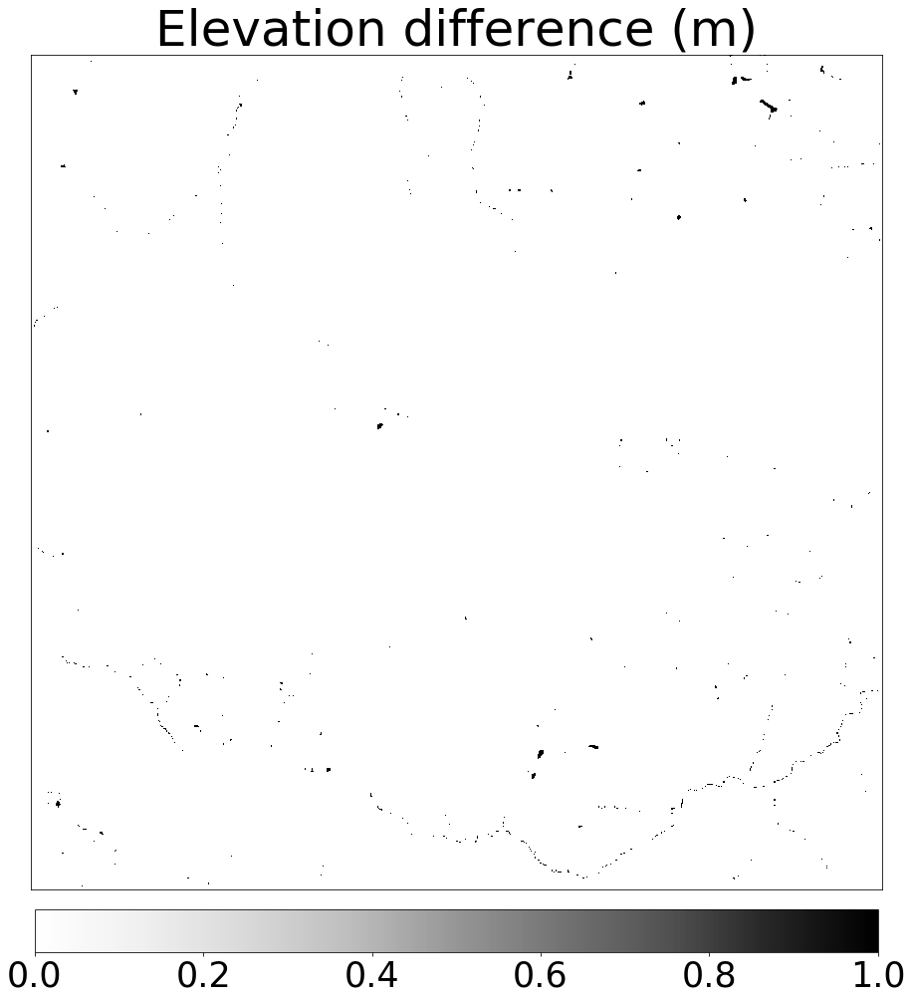

In [70]:
plt.figure(figsize=(15,15))
diff = dem_ns-dem[1:-1,1:-1]
diff[diff > 0] = 1
plt.imshow(diff,cmap='Greys')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Elevation difference (m)',fontsize=50)
plt.tight_layout()
plt.show()

# Let's try the upslope contributing area again

In [90]:
# Accumulation area
m = np.copy(dem_ns)
m[:] = 1
(area,fdir) = terrain_tools.ttf.calculate_d8_acc(dem_ns,m,10)

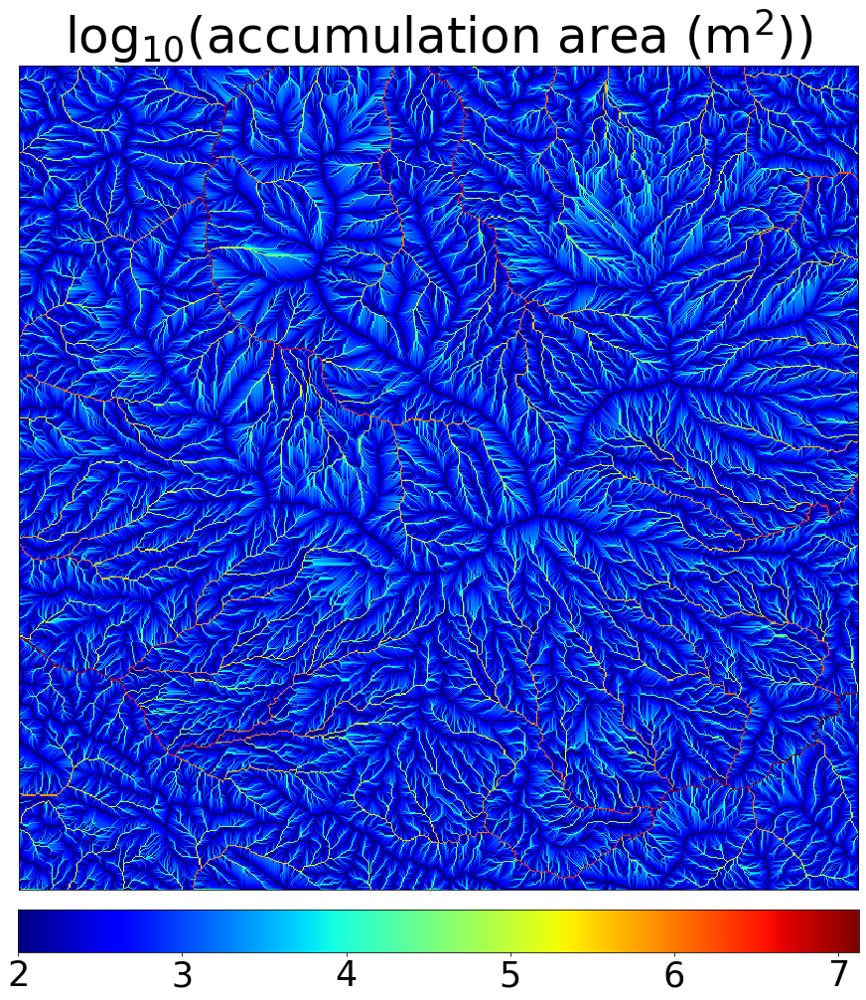

In [91]:
plt.figure(figsize=(15,15))
plt.imshow(np.log10(area),cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title(r'log$_{10}$(accumulation area (m$^2$))',fontsize=50)
plt.tight_layout()
plt.show()

# Zoomed example again

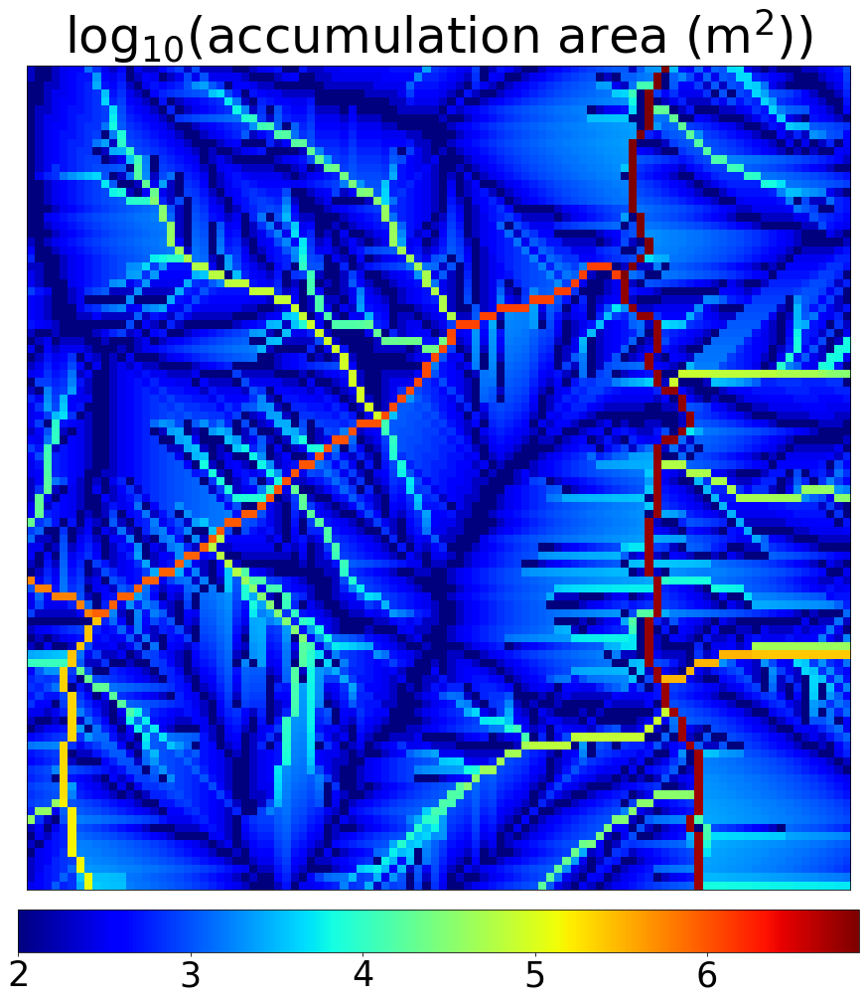

In [92]:
plt.figure(figsize=(15,15))
plt.imshow(np.log10(area[100:200,100:200]),cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title(r'log$_{10}$(accumulation area (m$^2$))',fontsize=50)
plt.tight_layout()
plt.show()

# Channel delineation: Concept and example

Where are the streams? Defining where channels begin from DEMs is actually a VERY hard problem that remains largely unresolved. However, we have ad-hoc methods. The most common is assume that all points where $A > A_{min}$ is a channel. The problem here is that $A_{min}$ is user-defined and is strongly variable. 

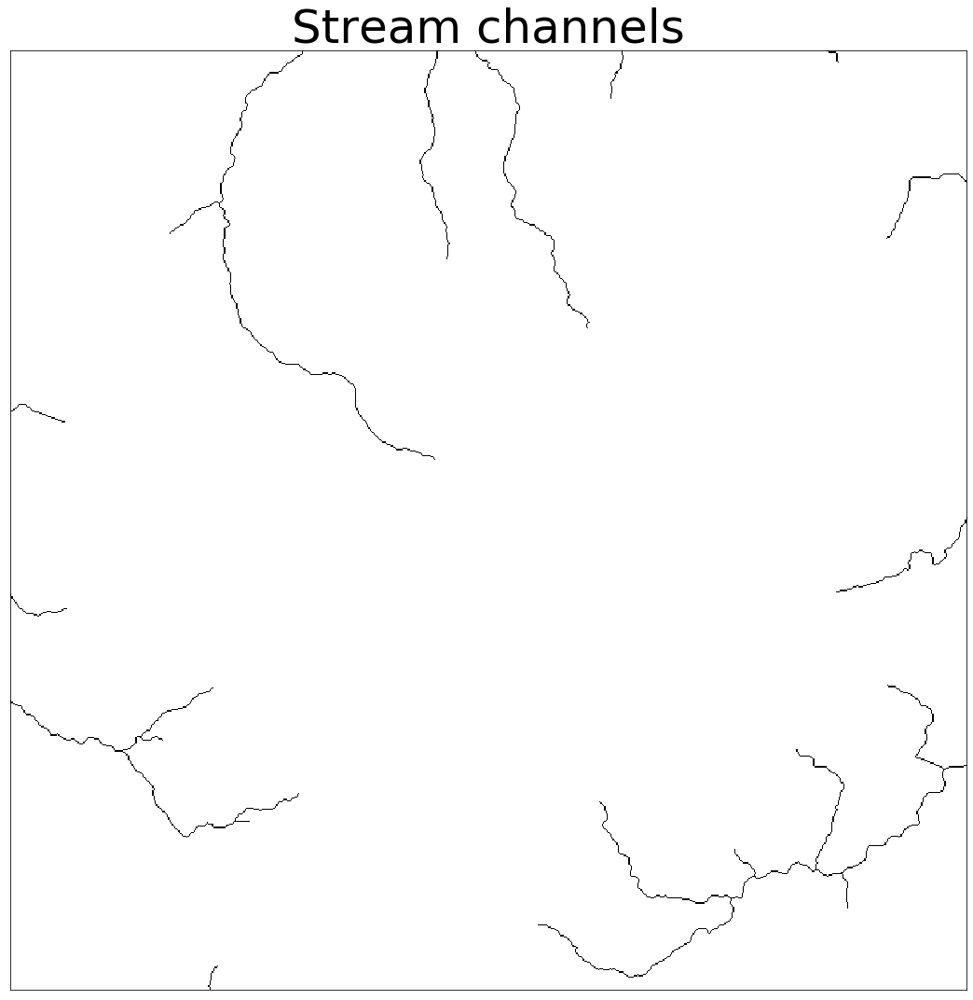

In [93]:
#Calculate channels
Amin = 10**6 #m2
channels = np.zeros(area.shape)
channels[area > Amin] = 1
#Plot
plt.figure(figsize=(15,15))
plt.imshow(channels,cmap='Greys')
plt.xticks([])
plt.yticks([])
plt.title('Stream channels',fontsize=50)
plt.tight_layout()
plt.show()

# The $A_{min}$ threshold matters a lot...

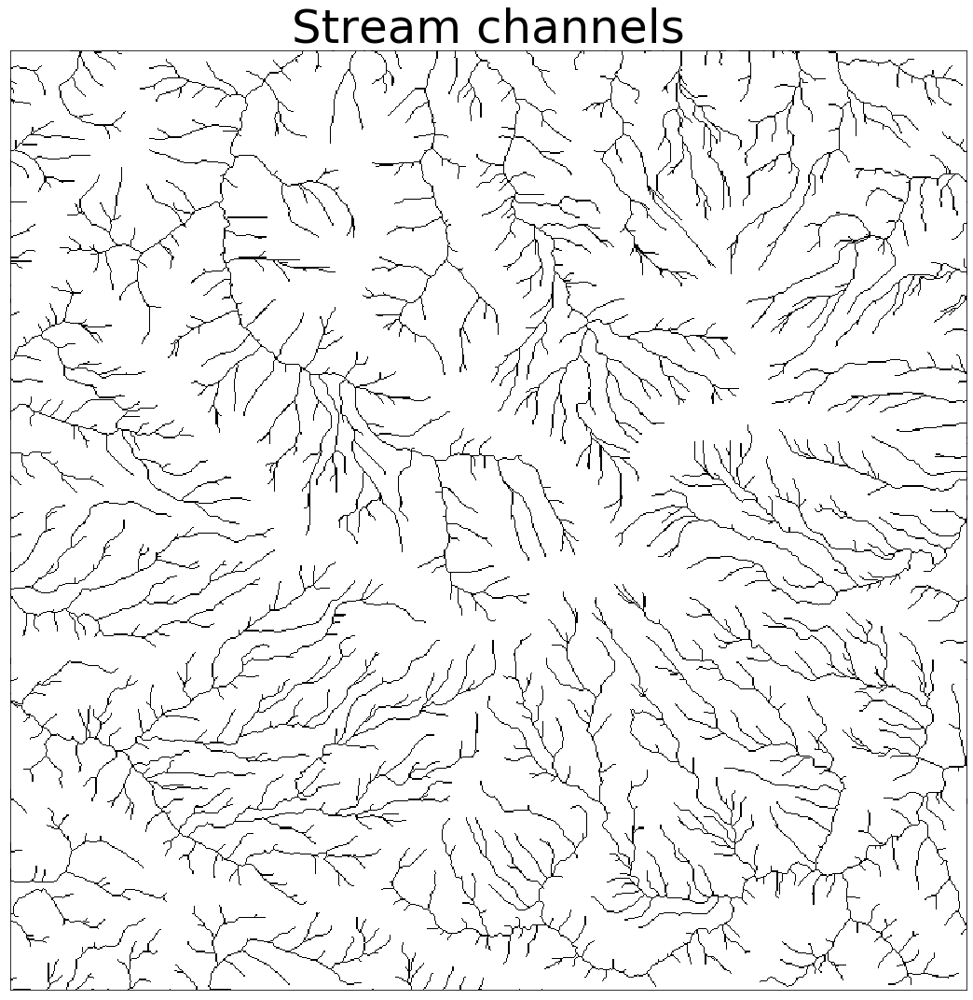

In [94]:
#Calculate channels
Amin = 10**4 #m2
channels = np.zeros(area.shape)
channels[area > Amin] = 1
#Plot
plt.figure(figsize=(15,15))
plt.imshow(channels,cmap='Greys')
plt.xticks([])
plt.yticks([])
plt.title('Stream channels',fontsize=50)
plt.tight_layout()
plt.show()

# Stream channels on top of elevation map


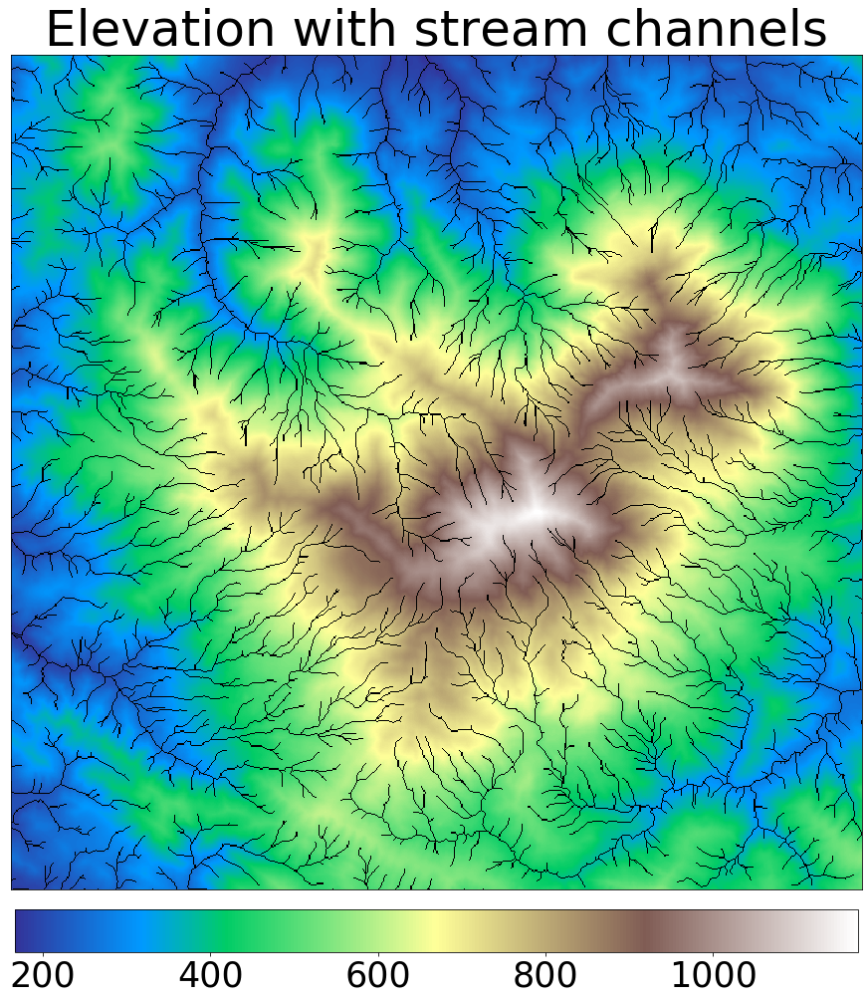

In [95]:
#Plot
plt.figure(figsize=(15,15))
plt.imshow(dem,cmap='terrain')
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
channels = np.ma.masked_array(channels,channels==0)
plt.imshow(channels,cmap='Greys_r')
plt.xticks([])
plt.yticks([])
plt.title('Elevation with stream channels',fontsize=50)
plt.tight_layout()
plt.show()

# Topographic index

It is a commonly used hydrologic index that is related to the steady-state "wetness" of a given pixel in certain conditions.

In the topographic index, $a$ is the accumulation area per unit contour length ($a \approx A/\Delta x$) and $\tan \beta$ is the slope.

$$\lambda = \ln\frac{a}{tan \beta}$$

In [101]:
# Topographic index
ac = area/10
tanb = slope/100
ti = np.log(ac/tanb)

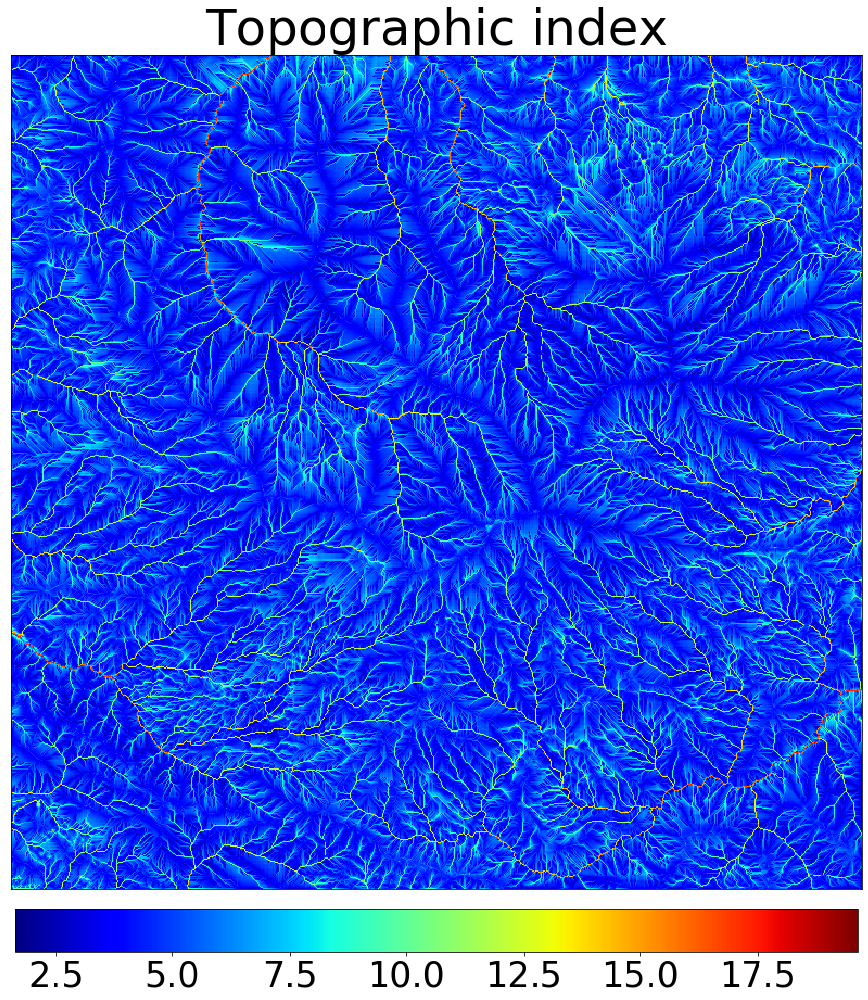

In [103]:
plt.figure(figsize=(15,15))
plt.imshow(ti,cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Topographic index',fontsize=50)
plt.tight_layout()
plt.show()

# Topographic index: Zoomed in

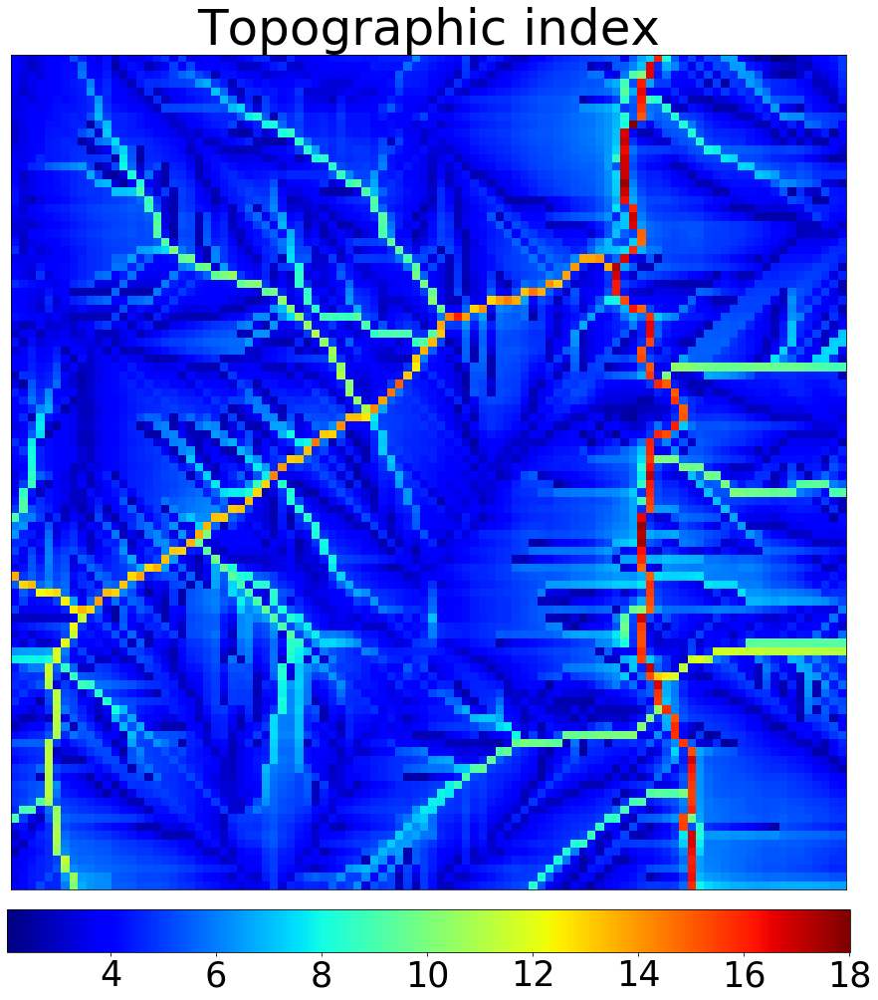

In [105]:
plt.figure(figsize=(15,15))
plt.imshow(ti[100:200,100:200],cmap='jet')
plt.xticks([])
plt.yticks([])
cb = plt.colorbar(orientation='horizontal',shrink=0.8,pad=0.02)
cb.ax.tick_params(labelsize=35)
plt.title('Topographic index',fontsize=50)
plt.tight_layout()
plt.show()

# There are many, many more attributes one can derive.

# But we are going to stop there.

# Terrain analysis software?

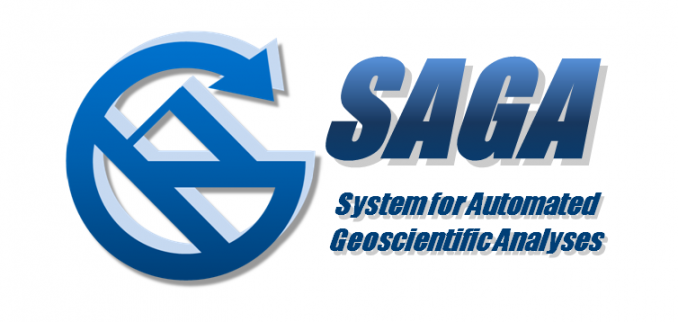

Has both a GUI and command line interfaces (I only use the command line one). 

Most comprehensive terrain analysis out there and pretty straightforward to use (once you manage to install it...).

# Other terrain analysis?

* gdaldem (command line)
* TauDEM (command line)
* Grass (GUI)
* QGis (GUI)
* ArcGIS (GUI)
* There are lots of R and Python packages that are popping up as well.

# Applications?

* Additional features for Regression/Classification?
* More features to add to our clustering algorithms?

# Using terrain analysis in clustering

In [163]:
import sklearn.cluster
import sklearn.preprocessing
X = []
X.append(slope.reshape(slope.size))
X.append(np.log10(area).reshape(slope.size))
X.append(dem[1:-1,1:-1].reshape(slope.size))
X.append(x.reshape(slope.size)) #east/west
X.append(y.reshape(slope.size)) #north/south
X = np.array(X).T
#Standardize X
clf = sklearn.preprocessing.StandardScaler().fit(X)
Xstd = clf.transform(X)
#Apply kmeans
clf = sklearn.cluster.KMeans(n_clusters=10,random_state=0).fit(Xstd[::100,:])
clusters = clf.predict(Xstd)

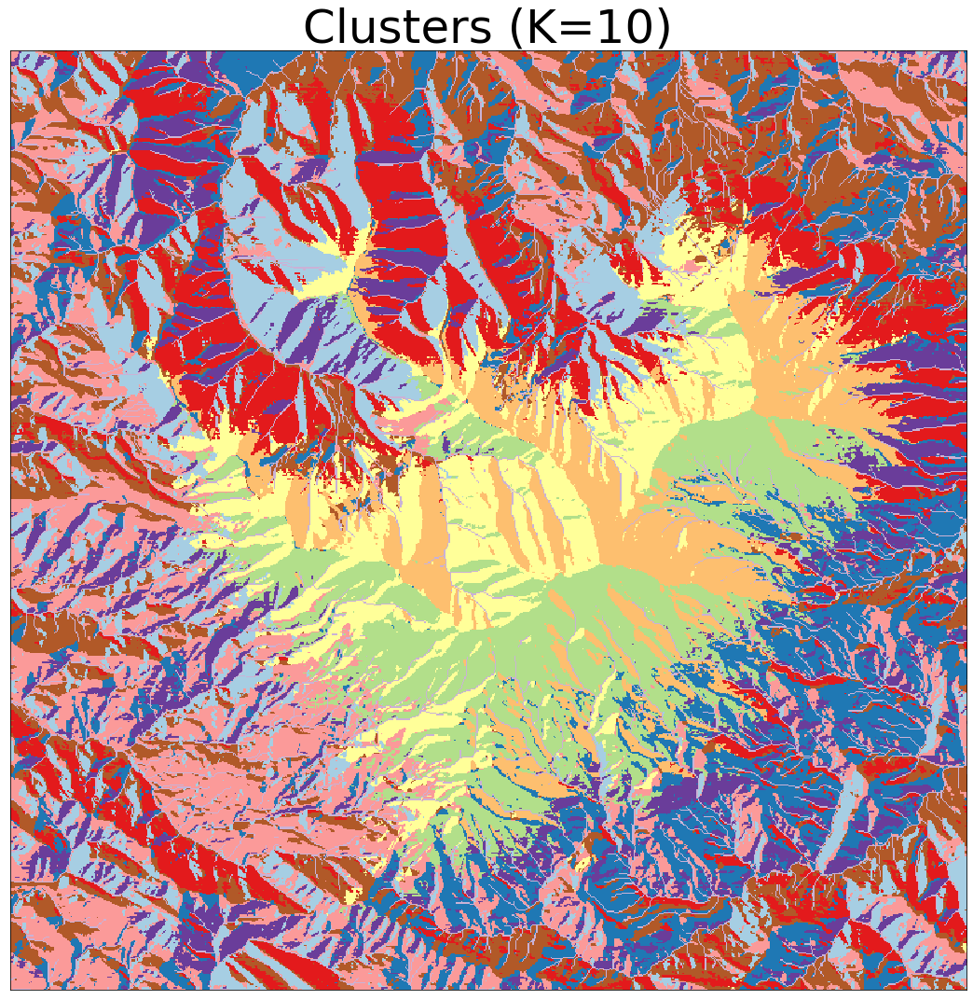

In [164]:
plt.figure(figsize=(15,15))
plt.imshow(clusters.reshape(slope.shape),cmap='Paired')
plt.xticks([])
plt.yticks([])
plt.title('Clusters (K=10)',fontsize=50)
plt.tight_layout()
plt.show()

# Next Tuesday: Speeding up your code